In [147]:
import random, csv, sys, itertools
import pandas as pd
import numpy as np
import re
from api_keys import api_keys, user
import random, csv, sys, itertools
from sklearn.cluster import KMeans
from geopy import geocoders 
import matplotlib
import matplotlib.pyplot as plt
import operator
import datetime
import sys
from time import time
import imageio
import folium
import folium.plugins as plugins
from mpl_toolkits.basemap import Basemap

%matplotlib inline

df = pd.read_csv('../data/clean_data_v3.csv', parse_dates=['date'])
df.columns

Index(['Unnamed: 0', 'incident_id', 'date', 'state', 'city_or_county',
       'address', 'n_killed', 'n_injured', 'incident_url', 'source_url',
       'incident_url_fields_missing', 'congressional_district', 'gun_stolen',
       'gun_type', 'incident_characteristics', 'latitude', 'longitude',
       'n_guns_involved', 'notes', 'participant_age',
       'participant_average_age', 'participant_age_group',
       'participant_gender', 'participant_relationship', 'participant_status',
       'participant_type', 'sources', 'state_house_district',
       'state_senate_district'],
      dtype='object')

Text(0.5,1,'Shootings in USA')

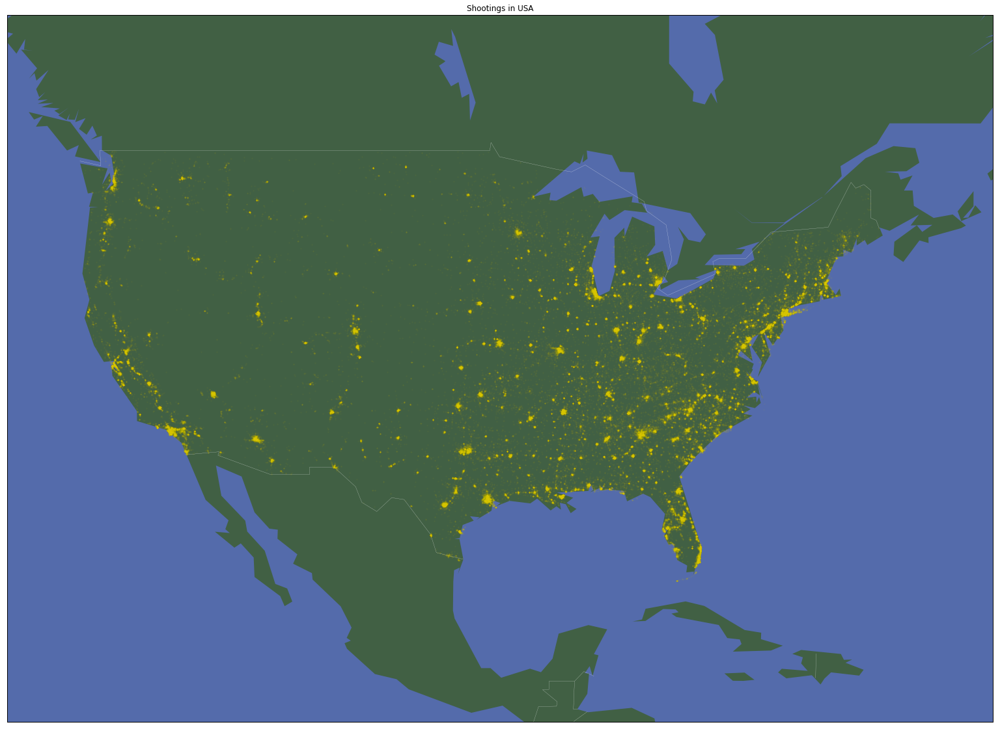

In [42]:
plt.figure(figsize=(40,20))
incident_map = Basemap(projection='merc',
             llcrnrlat=15,
             urcrnrlat=55,
             llcrnrlon=-130,
             urcrnrlon=-59,
             lat_ts=35,
             resolution='c')

incident_map.fillcontinents(color='#416044',lake_color='#546bab') 
incident_map.drawmapboundary(fill_color='#546bab')    
incident_map.drawcountries(linewidth=0.2, color="w")              

# Plot the data
map_xy = incident_map(df['longitude'].tolist(), df['latitude'].tolist())
incident_map.scatter(map_xy[0], map_xy[1], s=5, color="#e9d700", lw=0, alpha=0.05, zorder=5)

plt.title("Shootings in USA")

In [138]:
#TODO
# per city, groupby, per state, groupby
# circle radius is amount of incidents

folium_map = folium.Map(location=[40.738, -95.98],
                            zoom_start=4,
                            tiles="CartoDB dark_matter")

# for each row in the data, add a cicle marker
for index, row in df.head(10000).iterrows():
    # generate the popup message that is shown on click.
    popup_text = "incident_id: {}<br> incident_characteristics: {}"
    popup_text = popup_text.format(row["incident_id"],
                      row["incident_characteristics"])

    # radius of circles
    radius = 20
    color = '#E37222'
    
    # add marker to the map
    folium.CircleMarker(location=(row['latitude'], row['longitude']),
                        color=color,
                        popup=popup_text,
                        fill=True).add_to(folium_map)


#folium.CircleMarker(location=[40.738, -95.98],fill=True).add_to(folium_map)

    
folium_map

In [213]:
df1 = df[['date', 'state', 'city_or_county', 'n_killed', 'n_injured', 'longitude', 'latitude']]

df1 = df1[(df1['longitude'].notna()) & (df1['longitude'].notna())].reset_index(drop=True)

start = time()

N_CLUSTERS = 250

df1['cluster'] = KMeans(N_CLUSTERS, n_init=2, max_iter=50, random_state=42).fit_predict(df1[['latitude','longitude']])
incidents_groupby_cluster = df1[['state', 'city_or_county', 'latitude','longitude', 'n_injured', 'n_killed', 'cluster']]
incidents_groupby_cluster = incidents_groupby_cluster.groupby(incidents_groupby_cluster.cluster)


cluster_df = incidents_groupby_cluster.sum().reset_index(drop=True)
cluster_df['longitude'] = incidents_groupby_cluster.mean()[['longitude']]
cluster_df['latitude'] = incidents_groupby_cluster.mean()[['latitude']]


In [214]:
import plotly
plotly.offline.init_notebook_mode() # run at the start of every notebook
import cufflinks as cf
cf.go_offline()
cf.getThemes()
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)


colors = ["rgb(0,116,217)","rgb(255,65,54)","rgb(133,20,75)","rgb(255,133,27)","lightgrey"]


def join_names(names):
    return '/'.join([name for name in sorted(set(names))])

cluster_df['states'] = incidents_groupby_cluster['state'].apply(join_names)
cluster_df['severity'] = ((2*cluster_df['n_killed']+cluster_df['n_injured'])**0.3)
cluster_df['death_pct'] = cluster_df['n_killed']/(cluster_df['n_killed']+cluster_df['n_injured'])
cluster_df.sort_values(by=['severity', 'death_pct'], inplace=True)

# future = m.make_future_dataframe(periods=270,freq='D')
# forecast = m.predict(future)
# fig = m.plot(forecast)

data = [ dict(
    type = 'scattergeo',
    lon = cluster_df['longitude'],
    lat = cluster_df['latitude'],
    text = '<b>States: </b>'+cluster_df['states']
        +'<br><b>Injuries: </b>'+cluster_df['n_injured'].apply(str)
        +'<br><b>Deaths: </b>'+cluster_df['n_killed'].apply(str),
    marker = dict(
        size = 3*cluster_df['severity'],
        line = dict(
            width = 0.5
        ),
        cmin = cluster_df['severity'].min(),
        color = cluster_df['severity'],
        cmax = cluster_df['severity'].max(),
        opacity = 0.95,
    )
)]

layout = dict(
    title = 'Focuses of violence',
    colorbar = True,
    geo = dict(
        projection=dict( type='albers usa' ),
        subunitcolor = "rgb(221, 221, 221)",
        subunitwidth = 1.0
    )
)

fig = dict(data=data, layout=layout)
iplot(fig, validate=False)